# use NN method mask circadian effect

In [ ]:
sc.pp.highly_variable_genes(ad, layer='sx', n_top_genes=3000, flavor='seurat_v3', batch_key='CT')

In [ ]:
ad_test = ad[:, ad.var['highly_variable']].copy()

In [ ]:
ad_test.X = ad_test.layers["sx_log"]

In [ ]:
sc.tl.pca(ad_test)

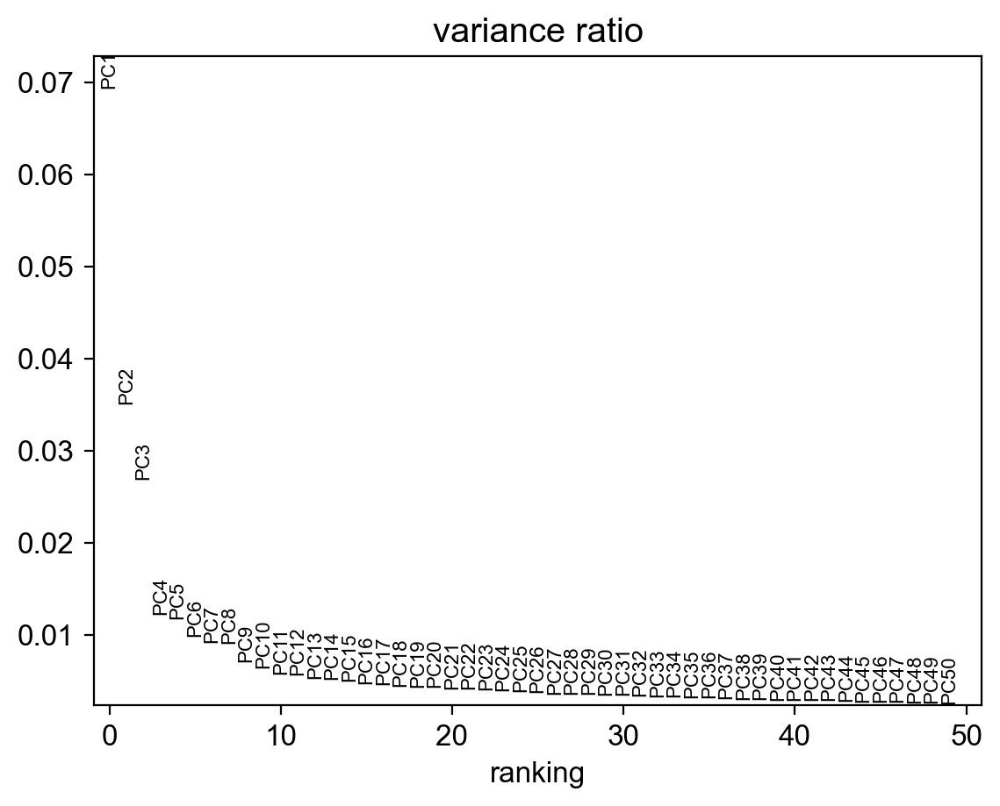

In [ ]:
sc.pl.pca_variance_ratio(ad_test, 50)

In [ ]:
# ad_test.obsm['X_pca'] = ad.obsm['X_pca_only_concate']

In [ ]:
sc.pp.neighbors(ad_test, n_pcs=30)

In [ ]:
sc.tl.umap(ad_test, 0.3)

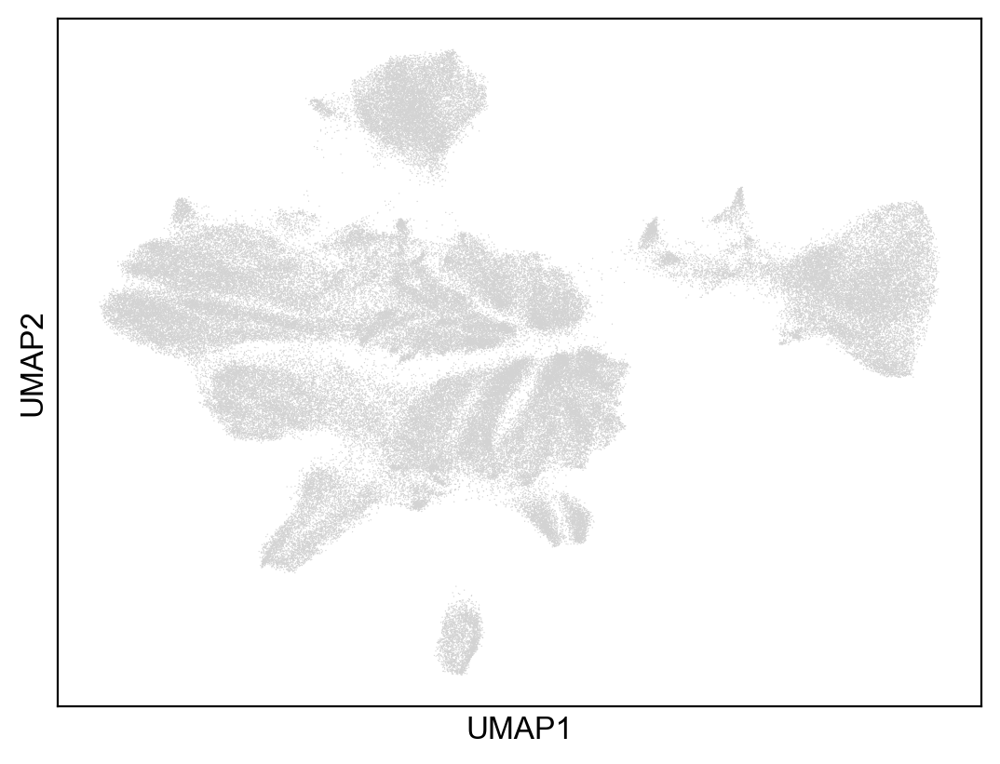

In [ ]:
sc.pl.umap(ad_test)

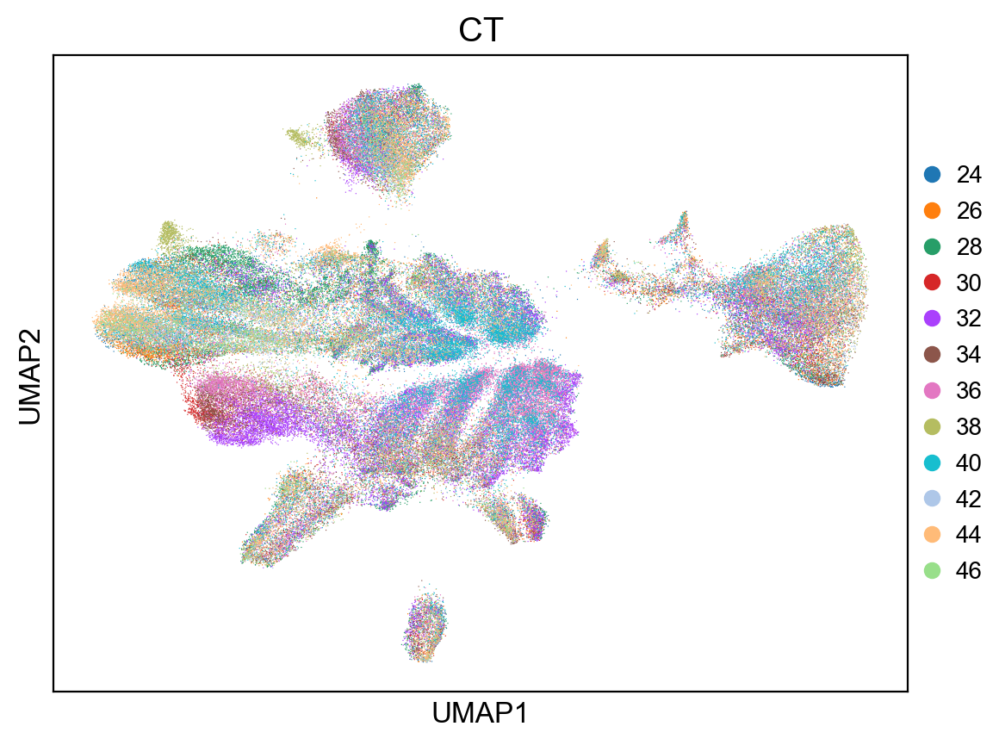

In [ ]:
sc.pl.umap(ad_test, color="CT")

In [ ]:
# ad.obsm['X_pca_only_concate'] = ad_test.obsm['X_pca']

In [ ]:
singleCellTools.plotting.PlotAnndata(ad_test, 'sx').embedding('umap', color='Batch', wrap=2, figsize=(10,4), groupby='Batch', addBackground=True, size=0.1, needLegend=False)[1]

In [ ]:
ad_test.obs['CT'] = ad_test.obs['CT'].cat.set_categories([*ad_test.obs['CT'].cat.categories[::2], *ad_test.obs['CT'].cat.categories[1::2]])

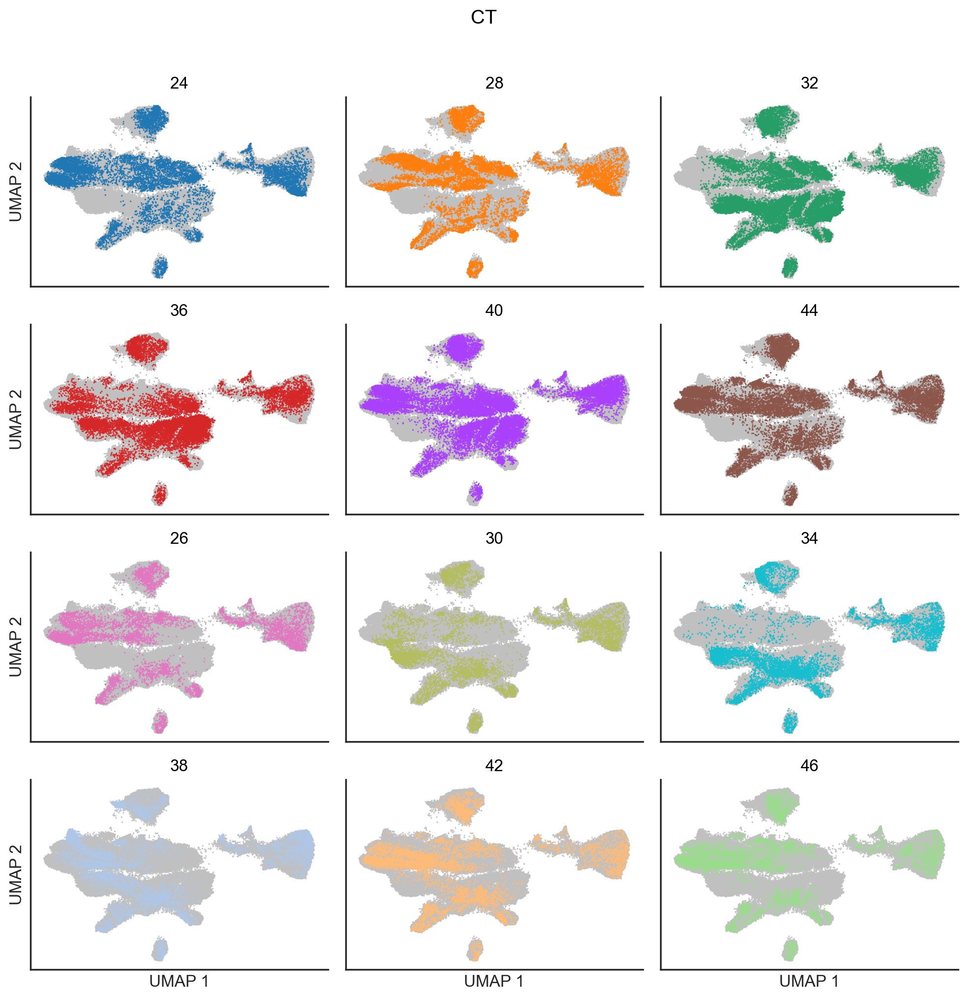

In [ ]:
singleCellTools.plotting.PlotAnndata(ad_test, 'sx').embedding('umap', color='CT', wrap=3, figsize=(10,10), groupby='CT', addBackground=True, size=0.4, needLegend=False)[1]

In [ ]:
# fig, axs = plt.subplots(3, 4, figsize=(20, 10))
# axs = axs.reshape(-1)
# for sample, ax in zip(ad_test.obs["CT"].cat.categories, axs):
#     sc.pl.umap(
#         ad_test, color="CT", groups=[sample], ax=ax, show=False, legend_loc=None, size=5
#     )
#     ax.set_title(sample)
# plt.show()

## harmony

In [ ]:
import scanpy.external as sce

In [ ]:
ad_test.obsm["X_pca_30"] = ad_test.obsm["X_pca"][:, :30]

In [ ]:
sce.pp.harmony_integrate(ad_test, key="Batch", basis="X_pca_30")

2023-11-22 16:48:28,506 - harmonypy - INFO - Iteration 1 of 10
2023-11-22 16:48:28 - INFO - Iteration 1 of 10
2023-11-22 16:50:07,519 - harmonypy - INFO - Iteration 2 of 10
2023-11-22 16:50:07 - INFO - Iteration 2 of 10
2023-11-22 16:51:45,396 - harmonypy - INFO - Converged after 2 iterations
2023-11-22 16:51:45 - INFO - Converged after 2 iterations


In [ ]:
sc.pp.neighbors(ad_test, use_rep="X_pca_harmony")

In [ ]:
sc.tl.umap(ad_test, 0.3)

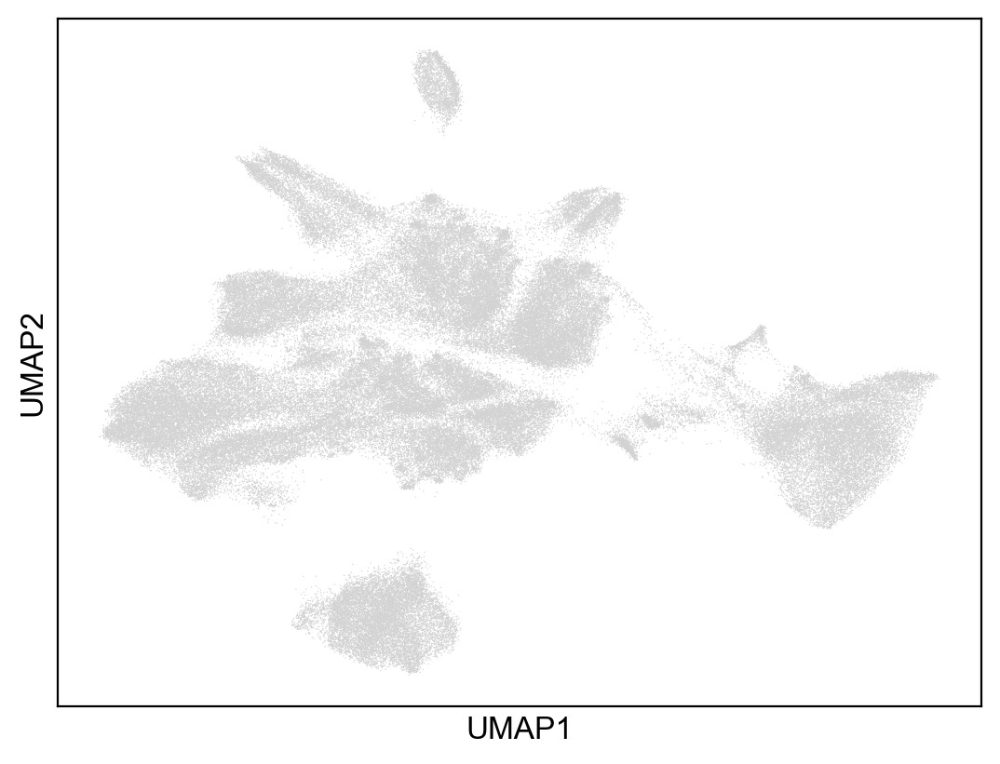

In [ ]:
sc.pl.umap(ad_test)

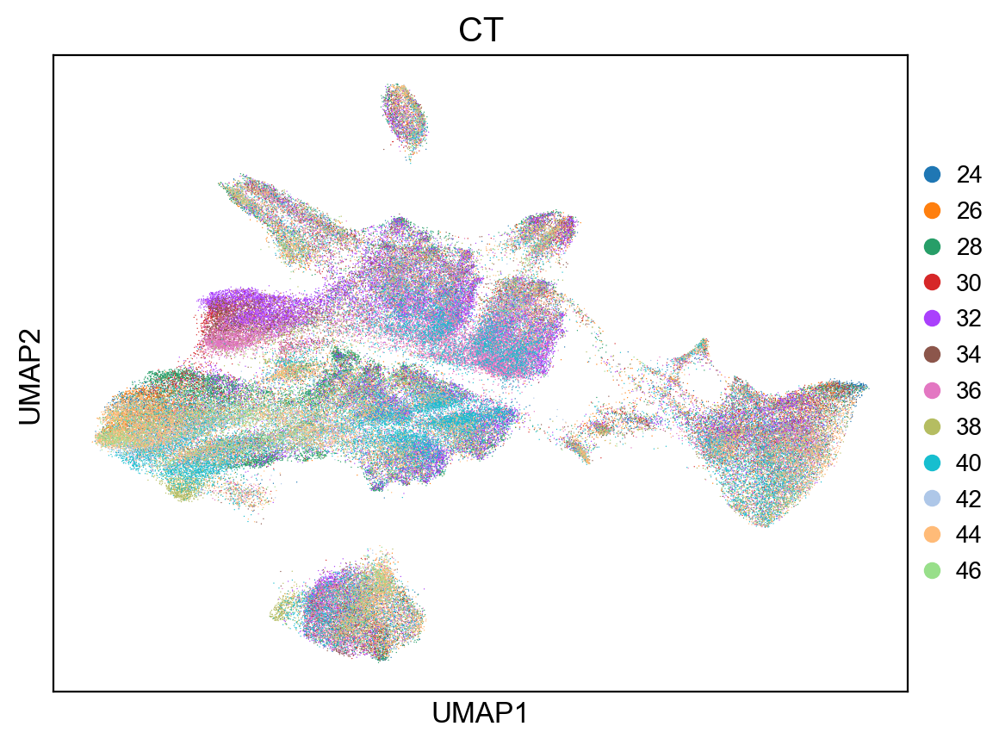

In [ ]:
sc.pl.umap(ad_test, color="CT")

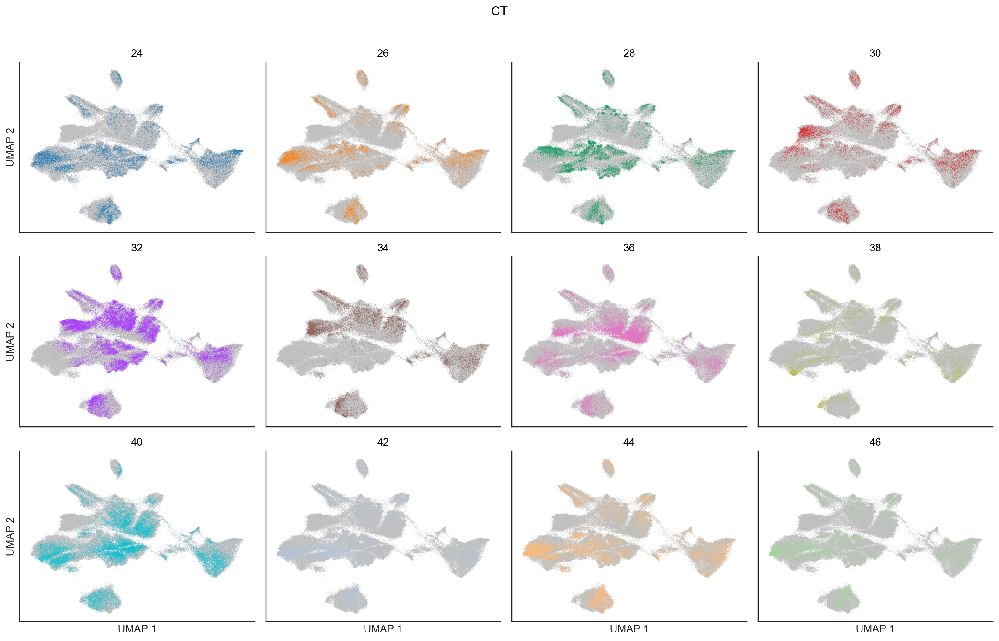

In [ ]:
singleCellTools.plotting.PlotAnndata(ad_test, 'sx').embedding('umap', color='CT', wrap=4, figsize=(16,10), groupby='CT', addBackground=True, size=0.1, needLegend=False)[1]

In [ ]:
ad.obsm['X_pca_only_harmony'] = ad_test.obsm['X_pca_harmony']

In [ ]:
# fig, axs = plt.subplots(3, 4, figsize=(20, 10))
# axs = axs.reshape(-1)
# for sample, ax in zip(ad_test.obs["CT"].cat.categories, axs):
#     sc.pl.umap(
#         ad_test, color="CT", groups=[sample], ax=ax, show=False, legend_loc=None, size=5
#     )
#     ax.set_title(sample)
# plt.show()

In [ ]:
# fig, axs = plt.subplots(2, 1, figsize=(5, 9))
# sc.pl.embedding(
#     ad_test,
#     "umap",
#     color="Batch",
#     groups=["1"],
#     ax=axs[0],
#     show=False,
#     title="Batch 1",
#     legend_loc=None,
# )
# sc.pl.embedding(
#     ad_test,
#     "umap",
#     color="Batch",
#     groups=["2"],
#     ax=axs[1],
#     show=False,
#     title="Batch 2",
#     legend_loc=None,
# )
# plt.show()

## harmony sample level

In [ ]:
import scanpy.external as sce

In [ ]:
ad_test.obsm["X_pca_30"] = ad_test.obsm["X_pca"][:, :30]

In [ ]:
sce.pp.harmony_integrate(ad_test, key="CT", basis="X_pca_30")

2023-11-22 16:58:58,895 - harmonypy - INFO - Iteration 1 of 10
2023-11-22 16:58:58 - INFO - Iteration 1 of 10
2023-11-22 17:00:43,891 - harmonypy - INFO - Iteration 2 of 10
2023-11-22 17:00:43 - INFO - Iteration 2 of 10
2023-11-22 17:02:26,776 - harmonypy - INFO - Iteration 3 of 10
2023-11-22 17:02:26 - INFO - Iteration 3 of 10
2023-11-22 17:04:04,985 - harmonypy - INFO - Iteration 4 of 10
2023-11-22 17:04:04 - INFO - Iteration 4 of 10
2023-11-22 17:05:42,726 - harmonypy - INFO - Iteration 5 of 10
2023-11-22 17:05:42 - INFO - Iteration 5 of 10
2023-11-22 17:07:26,545 - harmonypy - INFO - Iteration 6 of 10
2023-11-22 17:07:26 - INFO - Iteration 6 of 10
2023-11-22 17:09:10,653 - harmonypy - INFO - Iteration 7 of 10
2023-11-22 17:09:10 - INFO - Iteration 7 of 10
2023-11-22 17:10:50,090 - harmonypy - INFO - Iteration 8 of 10
2023-11-22 17:10:50 - INFO - Iteration 8 of 10
2023-11-22 17:12:34,165 - harmonypy - INFO - Iteration 9 of 10
2023-11-22 17:12:34 - INFO - Iteration 9 of 10
2023-11-22

In [ ]:
sc.pp.neighbors(ad_test, use_rep="X_pca_harmony")

In [ ]:
sc.tl.umap(ad_test, 0.3)

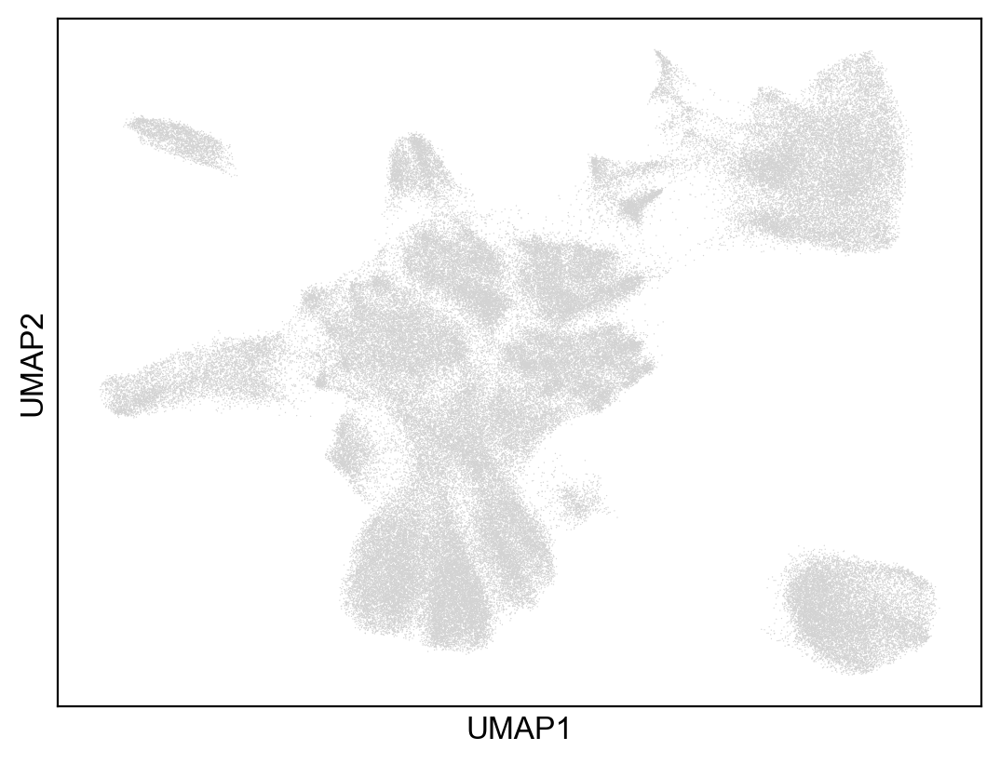

In [ ]:
sc.pl.umap(ad_test)

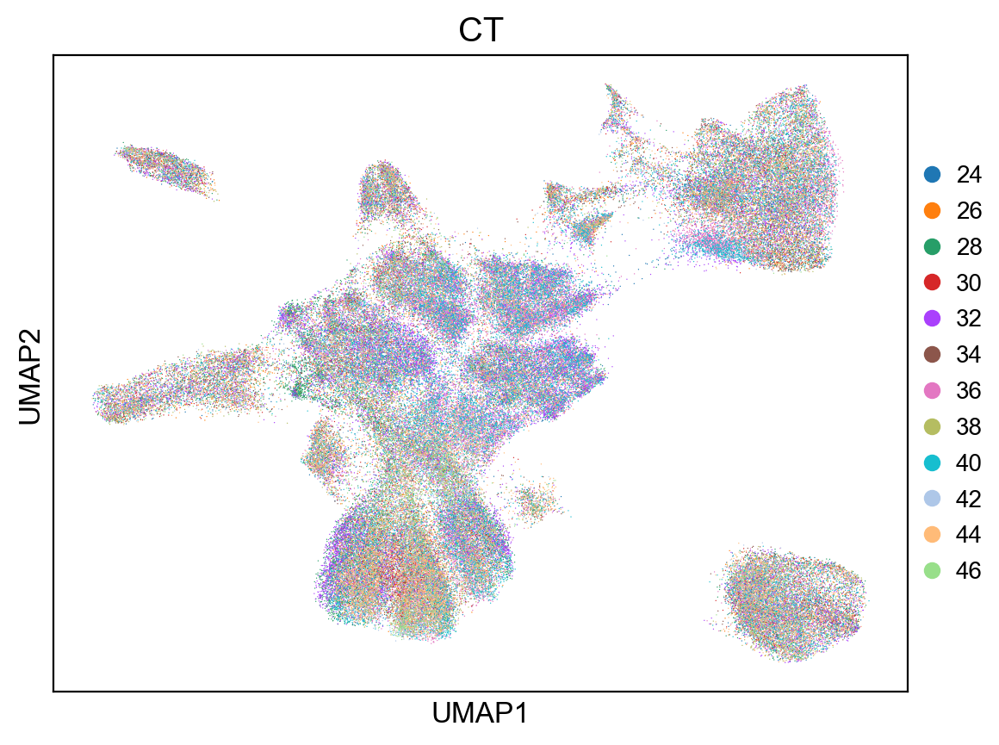

In [ ]:
sc.pl.umap(ad_test, color="CT")

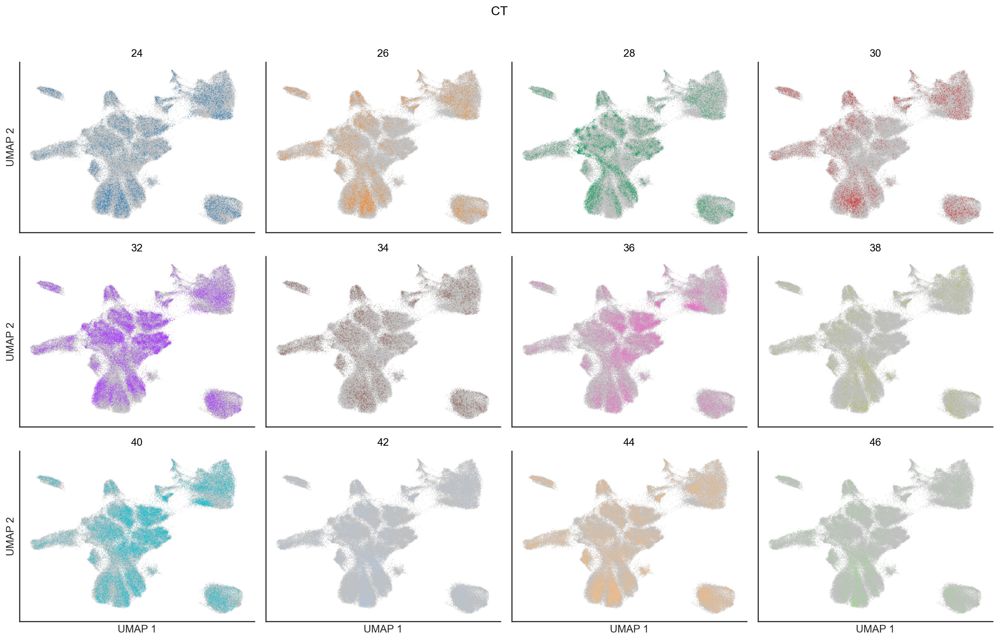

In [ ]:
singleCellTools.plotting.PlotAnndata(ad_test, 'sx').embedding('umap', color='CT', wrap=4, figsize=(16,10), groupby='CT', addBackground=True, size=0.1, needLegend=False)[1]

In [ ]:
sc.tl.leiden(ad_test, key_added='leiden_harmony_each_sample', resolution=1)

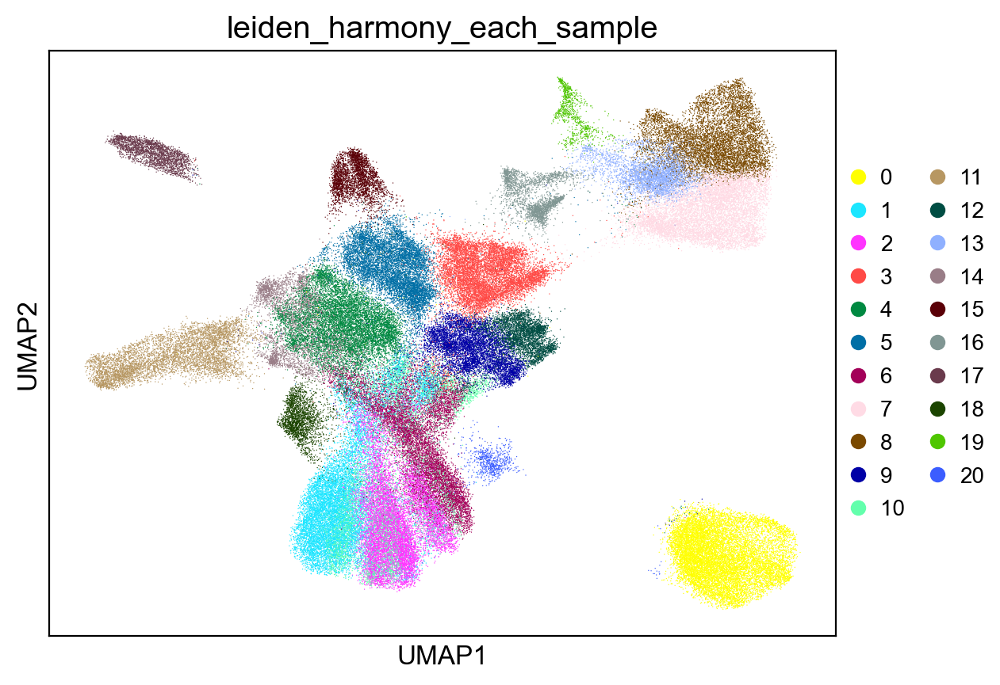

In [ ]:
sc.pl.umap(ad_test, color='leiden_harmony_each_sample')

In [ ]:
ad.obs['leiden_harmony_each_sample'] = ad_test.obs['leiden_harmony_each_sample'].copy()

In [ ]:
ad.obsm['X_pca_only_harmony_sample_level'] = ad_test.obsm['X_pca_harmony']

In [ ]:
import legendkit

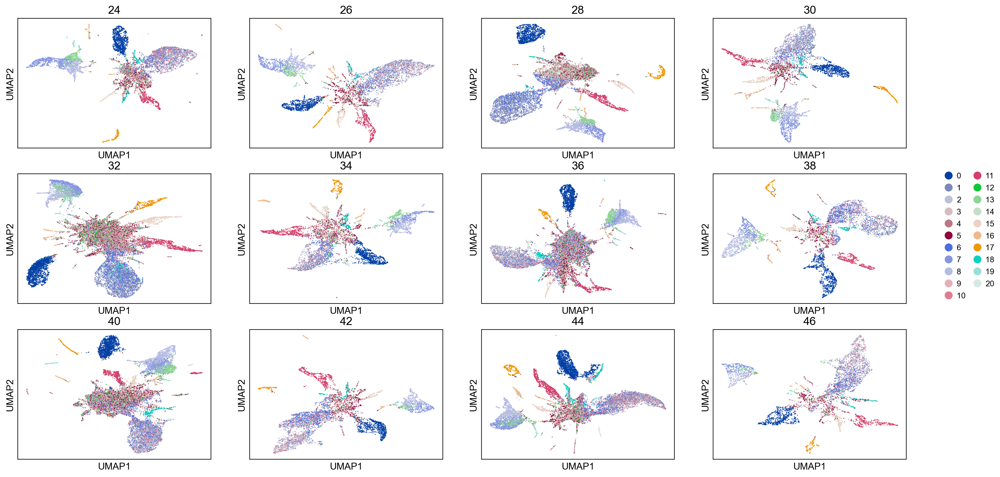

In [ ]:
dt_colors = pad.getAdColors('leiden_harmony_each_sample')

fig, axs = plt.subplots(3, 4, figsize=(20, 10))
axs = axs.reshape(-1)
for sample, ax in zip(ad_test.obs["CT"].cat.categories, axs):
    sc.pl.embedding(ad[ad.obs.eval("CT == @sample")], 'X_umap_each_cluster', ax=ax, show=False, legend_loc=None, color='leiden_harmony_each_sample', size=5)
    ax.set_title(sample)
    ax.set_xlabel("UMAP1")
    ax.set_ylabel("UMAP2")
fig.legend(handles=[legendkit.handles.CircleItem(color=x) for x in dt_colors.values()], labels=dt_colors.keys(), loc='center left', bbox_to_anchor=(0.93, 0.5), ncol=2)
plt.show()

## remove circadian genes

### get public circadian genes

In [ ]:
ls_pubCircadianGenes = []
dt_pubCircadianGenes = {}

#### Michael

In [ ]:
df_michael = pd.read_excel(
    "/data/Zhaijx/liuzj/projects/circadian/01_data/pubData/13059_2008_1992_MOESM2_ESM.xls",
    skiprows=2,
    header=[0, 1],
)

In [ ]:
_ls = []
for x, y in df_michael.columns:
    _ls.append(f"{x}_{y}")
df_michael.columns = _ls

In [ ]:
df_michael = pd.concat(
    [df_michael.loc[:, ["Identifiers_AGI"]], df_michael.filter(like="circadian")],
    axis=1,
)

In [ ]:
df_michael = df_michael.loc[lambda df: df.iloc[:, 1:].sum(axis=1) > 0]

In [ ]:
ls_pubCircadianGenes.extend(df_michael["Identifiers_AGI"].to_list())

In [ ]:
dt_pubCircadianGenes["Michael et al."] = (
    df_michael["Identifiers_AGI"].to_list() >> F(set) >> F(list)
)

#### Andres

In [ ]:
df_andres = pd.read_excel(
    "/data/Zhaijx/liuzj/projects/circadian/01_data/pubData/tpj14776-sup-0013-tables5.xlsx"
)

In [ ]:
ls_andres = df_andres["Combined circadian datasets (ALL)"].to_list()

In [ ]:
ls_pubCircadianGenes.extend(ls_andres)

In [ ]:
dt_pubCircadianGenes["Andres et al."] = ls_andres >> F(set) >> F(list)

#### Polly

In [ ]:
df_pollyCosopt = pd.read_csv(
    "/data/Zhaijx/liuzj/projects/circadian/01_data/pubData/pone.0049853.s006.csv",
    skiprows=2,
)

In [ ]:
df_pollyCosopt = df_pollyCosopt.query("`pMMC.Beta` < 0.05 & expressed == 'expressed'")

In [ ]:
df_pollyJtk = pd.read_csv(
    "/data/Zhaijx/liuzj/projects/circadian/01_data/pubData/pone.0049853.s007.csv",
    skiprows=1,
)

In [ ]:
df_pollyJtk = df_pollyJtk.query("`ADJ.P` < 0.05 & expressed == 'expressed'")

In [ ]:
ls_pubCircadianGenes.extend(
    list(set(df_pollyCosopt["GeneID"]) & set(df_pollyJtk["GeneID"]))
)

In [ ]:
ls_pubCircadianGenes = list(set(ls_pubCircadianGenes))

In [ ]:
dt_pubCircadianGenes["Polly et al."] = list(
    set(df_pollyCosopt["GeneID"]) & set(df_pollyJtk["GeneID"])
)

### start

In [ ]:
sc.pp.highly_variable_genes(ad, layer='sx', n_top_genes=8000, flavor='seurat_v3', batch_key='CT')

In [ ]:
ad_test = ad[:, ad.var['highly_variable']].copy()
ad_test.var["pubCircadian"] = ad_test.var.index.isin(ls_pubCircadianGenes)
ad_test = ad_test[:, ~ad_test.var.index.isin(ls_pubCircadianGenes)]

In [ ]:
ad_test = ad_test[:, ad_test.var.sort_values("highly_variable_rank").iloc[:3000].index]

In [ ]:
ad_test

View of AnnData object with n_obs × n_vars = 131152 × 3000
    obs: 'ambientRnaFractionEstimatedBySoupx', 'Sample', 'CT', 'n_genes', 'n_counts', 'percent_ct', 'outlier', '__group', 'Batch', 'leiden', 'prev_celltype', 'Cluster', 'celltype', 'leiden_0.05', 'leiden_0.1', 'leiden_0.15', 'leiden_0.2', 'leiden_0.25', 'leiden_0.3', 'leiden_0.35', 'leiden_0.4', 'leiden_0.45', 'leiden_0.5', 'leiden_0.55', 'leiden_0.6', 'leiden_0.65', 'leiden_0.7', 'leiden_0.75', 'leiden_0.8', 'leiden_0.85', 'leiden_0.9', 'leiden_0.95', 'leiden_1.0', 'leiden_1.05', 'leiden_1.1', 'leiden_1.15', 'leiden_1.2', 'leiden_1.25', 'leiden_1.3', 'leiden_1.35', 'leiden_1.4', 'leiden_1.45', 'leiden_1.5', 'leiden_subcluster', 'recluster_ct', 'temp_batch', 'temp_split', 'leiden_mask_all_circadian', 'leiden_harmony_each_sample', 'leiden_each_cluster'
    var: 'n_cells', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'pubCircadian'
    uns: 'Batch_colors', 'CT_colo

In [ ]:
ad_test.X = ad_test.layers["sx_log"]

In [ ]:
sc.tl.pca(ad_test)

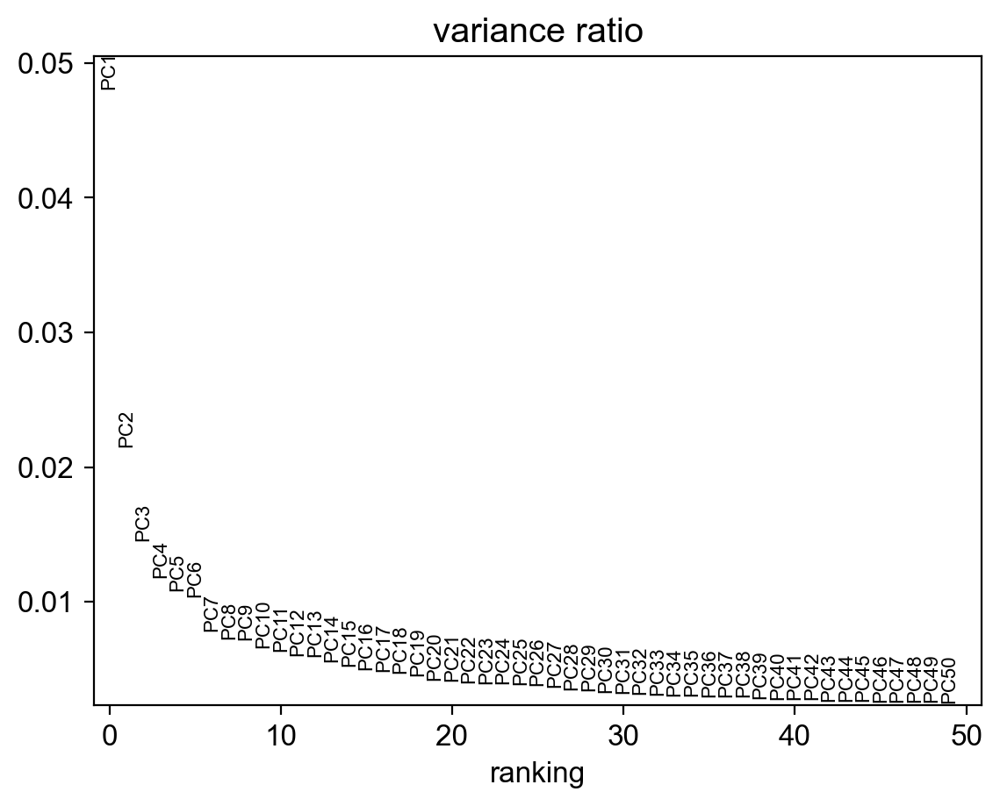

In [ ]:
sc.pl.pca_variance_ratio(ad_test, 50)

In [ ]:
sc.pp.neighbors(ad_test, n_pcs=30)

In [ ]:
sc.tl.umap(ad_test, 0.3)

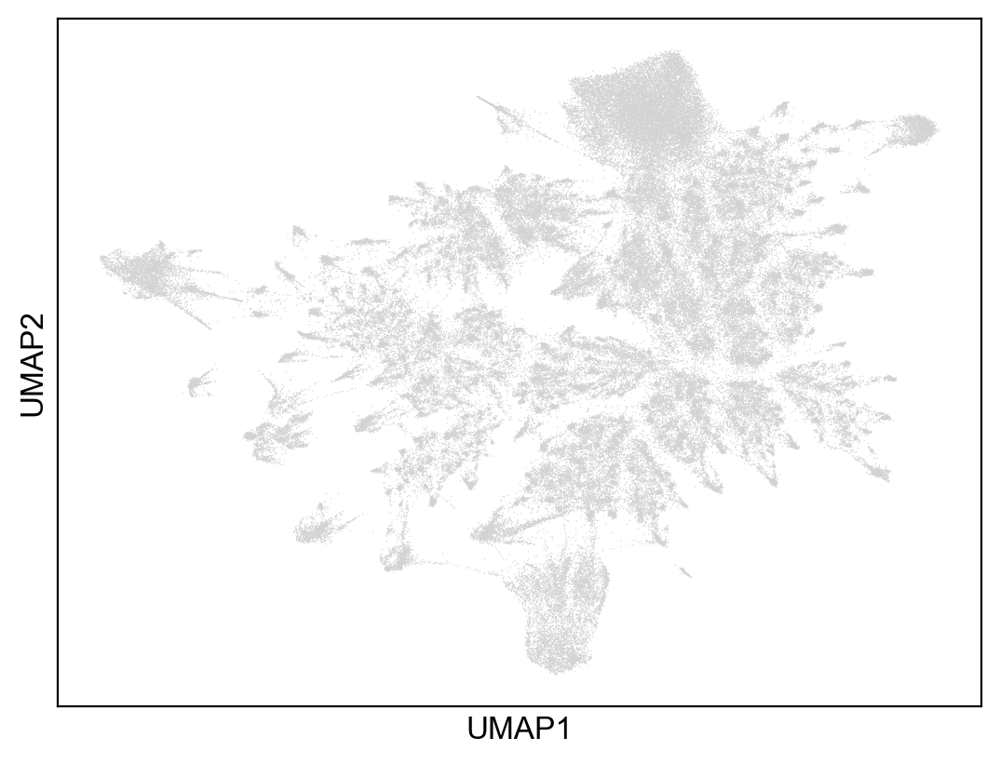

In [ ]:
sc.pl.umap(ad_test)

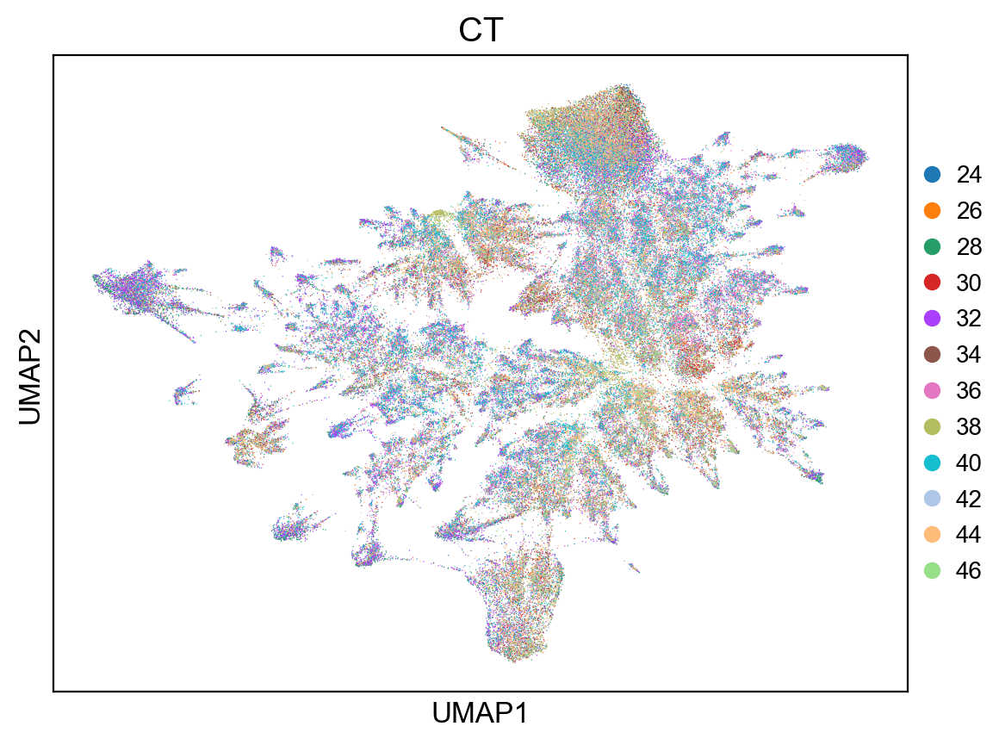

In [ ]:
sc.pl.umap(ad_test, color="CT")

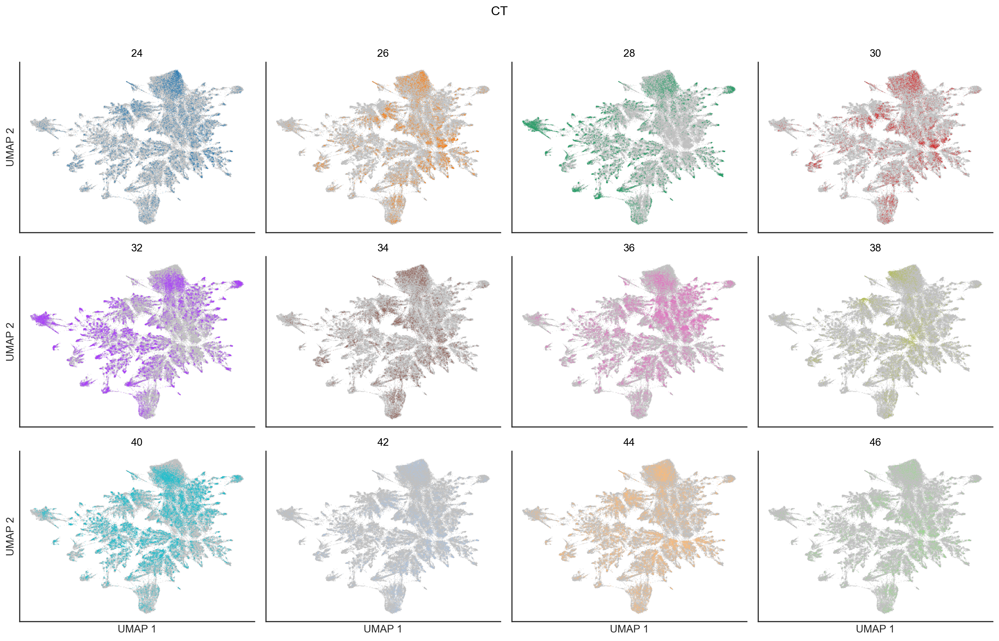

In [ ]:
singleCellTools.plotting.PlotAnndata(ad_test, 'sx').embedding('umap', color='CT', wrap=4, figsize=(16,10), groupby='CT', addBackground=True, size=0.1, needLegend=False)[1]

In [ ]:
ad.obsm['X_pca_only_concat_remove_circadian'] = ad_test.obsm['X_pca']

### remove random genes

In [ ]:
ls_randomGenes = list(ad.var.index.to_series().sample(n=12766))
sc.pp.highly_variable_genes(ad, layer='sx', n_top_genes=8000, flavor='seurat_v3', batch_key='CT')
ad_testControl = ad[:, ad.var['highly_variable']].copy()
ad_testControl.var["pubCircadian"] = ad_testControl.var.index.isin(ls_randomGenes)
ad_testControl = ad_testControl[:, ~ad_testControl.var.index.isin(ls_randomGenes)]
ad_testControl

View of AnnData object with n_obs × n_vars = 131152 × 3815
    obs: 'ambientRnaFractionEstimatedBySoupx', 'Sample', 'CT', 'n_genes', 'n_counts', 'percent_ct', 'outlier', 'Batch', 'leiden', 'prev_celltype', 'Cluster', 'celltype', 'leiden_0.05', 'leiden_0.1', 'leiden_0.15', 'leiden_0.2', 'leiden_0.25', 'leiden_0.3', 'leiden_0.35', 'leiden_0.4', 'leiden_0.45', 'leiden_0.5', 'leiden_0.55', 'leiden_0.6', 'leiden_0.65', 'leiden_0.7', 'leiden_0.75', 'leiden_0.8', 'leiden_0.85', 'leiden_0.9', 'leiden_0.95', 'leiden_1.0', 'leiden_1.05', 'leiden_1.1', 'leiden_1.15', 'leiden_1.2', 'leiden_1.25', 'leiden_1.3', 'leiden_1.35', 'leiden_1.4', 'leiden_1.45', 'leiden_1.5', 'leiden_subcluster', 'recluster_ct', 'temp_batch', 'temp_split', 'leiden_mask_all_circadian', 'leiden_harmony_each_sample', 'leiden_each_cluster', 'AT3G09600', 'AT3G54500', 'AT2G46830', 'AT5G02810', 'AT1G01060', 'AT5G61380', 'AT5G64170', 'AT5G60100', 'AT1G22770', 'AT5G02840', 'AT2G25930', 'AT2G46790', 'AT2G40080', 'AT5G24470', 'AT5G59

In [ ]:
ad_testControl = ad_testControl[:, ad_testControl.var.sort_values("highly_variable_rank").iloc[:3000].index]
ad_testControl

View of AnnData object with n_obs × n_vars = 131152 × 3000
    obs: 'ambientRnaFractionEstimatedBySoupx', 'Sample', 'CT', 'n_genes', 'n_counts', 'percent_ct', 'outlier', 'Batch', 'leiden', 'prev_celltype', 'Cluster', 'celltype', 'leiden_0.05', 'leiden_0.1', 'leiden_0.15', 'leiden_0.2', 'leiden_0.25', 'leiden_0.3', 'leiden_0.35', 'leiden_0.4', 'leiden_0.45', 'leiden_0.5', 'leiden_0.55', 'leiden_0.6', 'leiden_0.65', 'leiden_0.7', 'leiden_0.75', 'leiden_0.8', 'leiden_0.85', 'leiden_0.9', 'leiden_0.95', 'leiden_1.0', 'leiden_1.05', 'leiden_1.1', 'leiden_1.15', 'leiden_1.2', 'leiden_1.25', 'leiden_1.3', 'leiden_1.35', 'leiden_1.4', 'leiden_1.45', 'leiden_1.5', 'leiden_subcluster', 'recluster_ct', 'temp_batch', 'temp_split', 'leiden_mask_all_circadian', 'leiden_harmony_each_sample', 'leiden_each_cluster', 'AT3G09600', 'AT3G54500', 'AT2G46830', 'AT5G02810', 'AT1G01060', 'AT5G61380', 'AT5G64170', 'AT5G60100', 'AT1G22770', 'AT5G02840', 'AT2G25930', 'AT2G46790', 'AT2G40080', 'AT5G24470', 'AT5G59

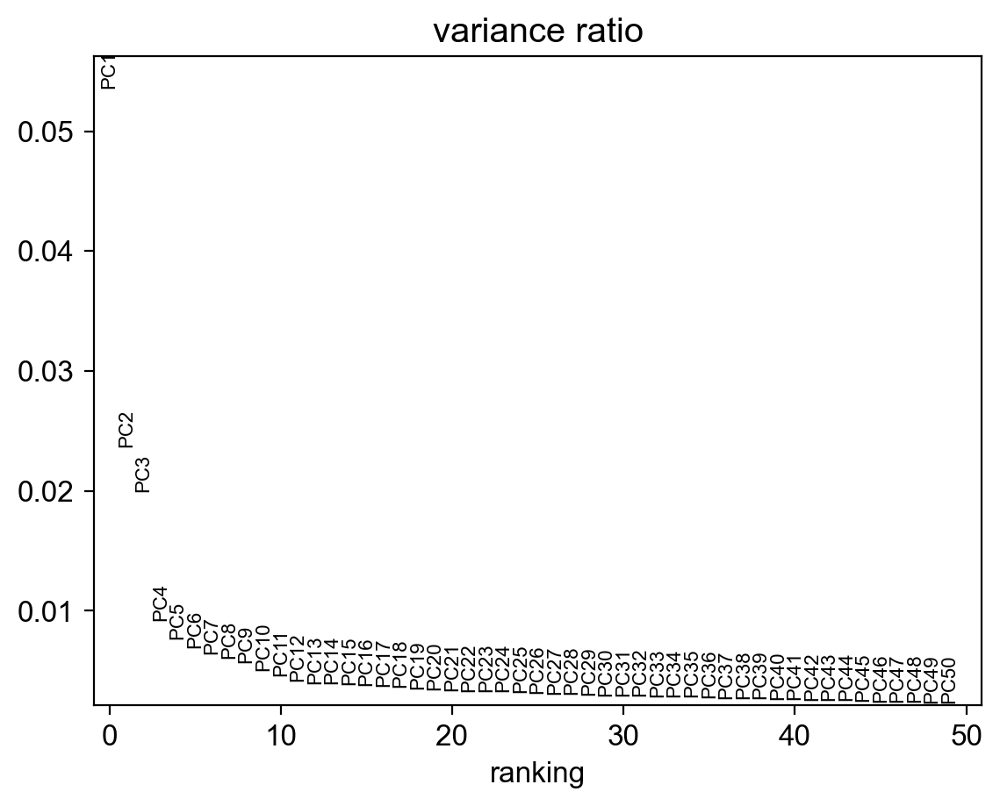

In [ ]:
ad_testControl.X = ad_testControl.layers["sx_log"]
sc.tl.pca(ad_testControl)
sc.pl.pca_variance_ratio(ad_testControl, 50)
sc.pp.neighbors(ad_testControl, n_pcs=30)

In [ ]:
ad.obsm['X_pca_only_concat_remove_random'] = ad_testControl.obsm['X_pca']

### harmony

In [ ]:
import scanpy.external as sce

In [ ]:
ad_test.obsm["X_pca_30"] = ad_test.obsm["X_pca"][:, :30]

In [ ]:
sce.pp.harmony_integrate(ad_test, key="Batch", basis="X_pca_30")

2023-11-22 17:40:03,685 - harmonypy - INFO - Iteration 1 of 10
2023-11-22 17:40:03 - INFO - Iteration 1 of 10
2023-11-22 17:41:35,920 - harmonypy - INFO - Iteration 2 of 10
2023-11-22 17:41:35 - INFO - Iteration 2 of 10
2023-11-22 17:43:03,190 - harmonypy - INFO - Iteration 3 of 10
2023-11-22 17:43:03 - INFO - Iteration 3 of 10
2023-11-22 17:44:28,571 - harmonypy - INFO - Iteration 4 of 10
2023-11-22 17:44:28 - INFO - Iteration 4 of 10
2023-11-22 17:45:57,942 - harmonypy - INFO - Iteration 5 of 10
2023-11-22 17:45:57 - INFO - Iteration 5 of 10
2023-11-22 17:47:26,969 - harmonypy - INFO - Iteration 6 of 10
2023-11-22 17:47:26 - INFO - Iteration 6 of 10
2023-11-22 17:47:53,746 - harmonypy - INFO - Iteration 7 of 10
2023-11-22 17:47:53 - INFO - Iteration 7 of 10
2023-11-22 17:48:19,687 - harmonypy - INFO - Iteration 8 of 10
2023-11-22 17:48:19 - INFO - Iteration 8 of 10
2023-11-22 17:48:45,248 - harmonypy - INFO - Iteration 9 of 10
2023-11-22 17:48:45 - INFO - Iteration 9 of 10
2023-11-22

In [ ]:
sc.pp.neighbors(ad_test, use_rep="X_pca_harmony")

In [ ]:
sc.tl.umap(ad_test, 0.3)

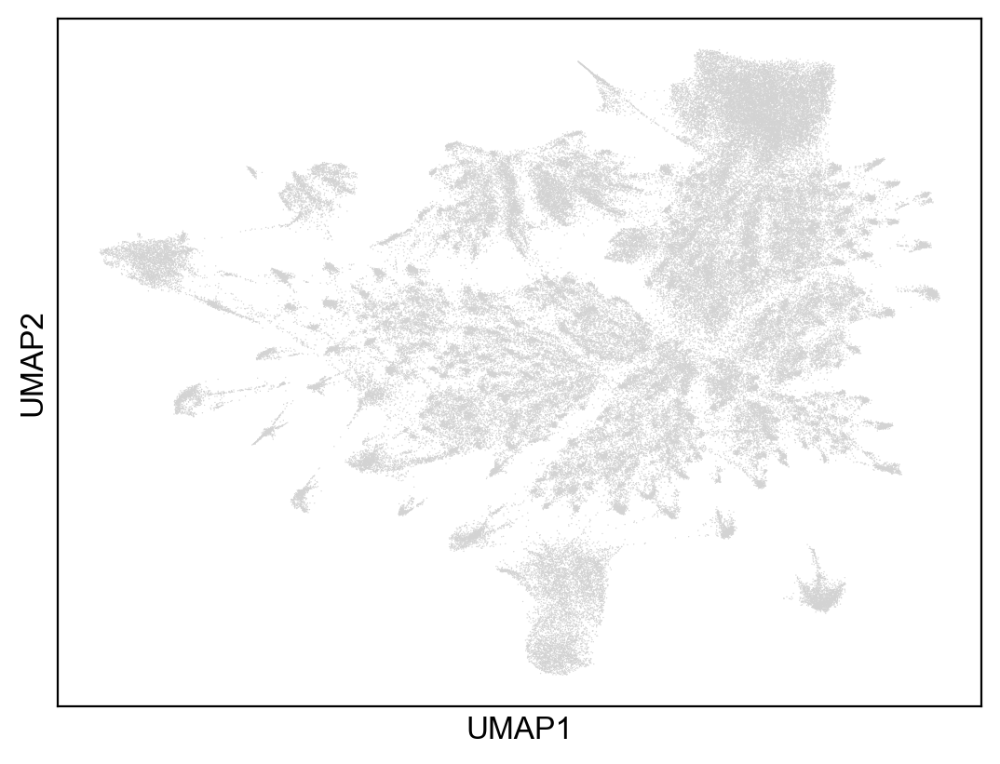

In [ ]:
sc.pl.umap(ad_test)

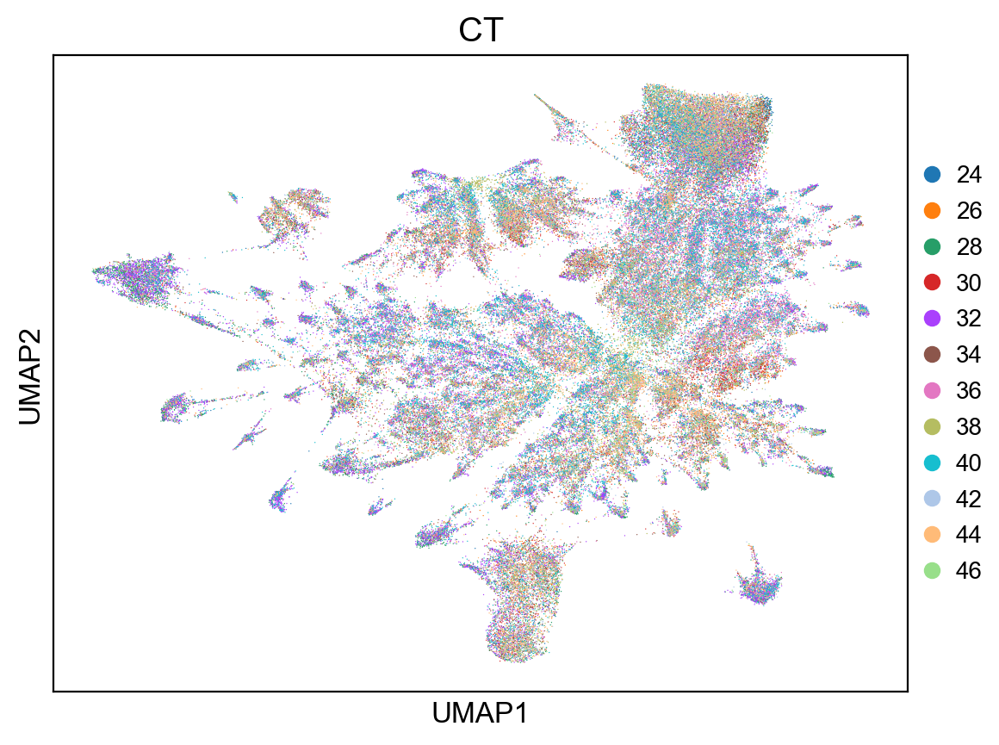

In [ ]:
sc.pl.umap(ad_test, color="CT")

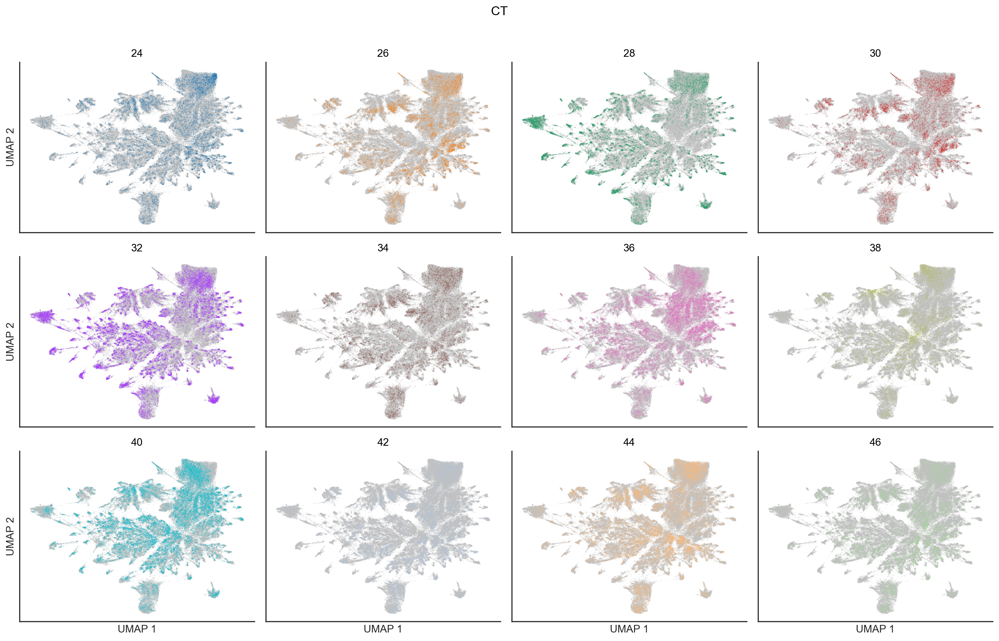

In [ ]:
singleCellTools.plotting.PlotAnndata(ad_test, 'sx').embedding('umap', color='CT', wrap=4, figsize=(16,10), groupby='CT', addBackground=True, size=0.1, needLegend=False)[1]

In [ ]:
ad.obsm['X_pca_harmony_remove_circadian'] = ad_test.obsm['X_pca_harmony']